# Suicide rates and risk - Prediction and Analysis 
# Aishwarya Ponkshe 

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import altair as alt
import warnings
warnings.filterwarnings('ignore')

In [2]:
df = pd.read_csv('master.csv')
df.head()

,country,year,sex,age,suicides_no,population,suicides/100k pop,country-year,HDI for year,gdp_for_year ($),gdp_per_capita ($),generation
0,Albania,1987,male,15-24 years,21,312900,6.71,Albania1987,NaN,"2,156,624,900",796,Generation X
1,Albania,1987,male,35-54 years,16,308000,5.19,Albania1987,NaN,"2,156,624,900",796,Silent
2,Albania,1987,female,15-24 years,14,289700,4.83,Albania1987,NaN,"2,156,624,900",796,Generation X
3,Albania,1987,male,75+ years,1,21800,4.59,Albania1987,NaN,"2,156,624,900",796,G.I. Generation
4,Albania,1987,male,25-34 years,9,274300,3.28,Albania1987,NaN,"2,156,624,900",796,Boomers


### Data treatment and cleaning

In [3]:
df.where(df['year'].between(1990,2014), inplace = True) #A parsed version from 1990-2014 was used to better interpret plots and save processing time. 

original_df = df[df['year'].notna()]
original_df

,country,year,sex,age,suicides_no,population,suicides/100k pop,country-year,HDI for year,gdp_for_year ($),gdp_per_capita ($),generation
36,Albania,1992.0,male,35-54 years,12.0,343800.0,3.49,Albania1992,NaN,"709,452,584",251.0,Boomers
37,Albania,1992.0,male,15-24 years,9.0,263700.0,3.41,Albania1992,NaN,"709,452,584",251.0,Generation X
38,Albania,1992.0,male,55-74 years,5.0,159500.0,3.13,Albania1992,NaN,"709,452,584",251.0,Silent
39,Albania,1992.0,male,25-34 years,7.0,245500.0,2.85,Albania1992,NaN,"709,452,584",251.0,Boomers
40,Albania,1992.0,female,15-24 years,7.0,292400.0,2.39,Albania1992,NaN,"709,452,584",251.0,Generation X
...,...,...,...,...,...,...,...,...,...,...,...,...
27815,Uzbekistan,2014.0,female,35-54 years,107.0,3620833.0,2.96,Uzbekistan2014,0.675,"63,067,077,179",2309.0,Generation X
27816,Uzbekistan,2014.0,female,75+ years,9.0,348465.0,2.58,Uzbekistan2014,0.675,"63,067,077,179",2309.0,Silent
27817,Uzbekistan,2014.0,male,5-14 years,60.0,2762158.0,2.17,Uzbekistan2014,0.675,"63,067,077,179",2309.0,Generation Z
27818,Uzbekistan,2014.0,female,5-14 years,44.0,2631600.0,1.67,Uzbekistan2014,0.675,"63,067,077,179",2309.0,Generation Z


In [4]:
original_df['year'] = original_df['year'].astype(object) 

Human Development Index (HDI) data

In [5]:
df3 = pd.read_csv('Human development index (HDI).csv')
df3.drop(['Human development index (HDI)'], axis=1, inplace = True)
df3.head()

,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
HDI Rank (2018),Country,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017
170,Afghanistan,0.298,0.304,0.312,0.308,0.303,0.327,0.331,0.335,0.339,0.343,0.345,0.347,0.378,0.387,0.400,0.410,0.419,0.431,0.436,0.447,0.464,0.465,0.479,0.485,0.488,0.490,0.491,0.493
69,Albania,0.644,0.625,0.608,0.611,0.617,0.629,0.639,0.639,0.649,0.660,0.667,0.673,0.680,0.687,0.692,0.702,0.709,0.718,0.724,0.729,0.740,0.759,0.771,0.781,0.787,0.788,0.788,0.789
82,Algeria,0.578,0.582,0.589,0.593,0.597,0.602,0.610,0.619,0.629,0.638,0.646,0.655,0.666,0.676,0.685,0.694,0.699,0.708,0.711,0.720,0.730,0.738,0.737,0.746,0.749,0.751,0.755,0.758
36,Andorra,..,..,..,..,..,..,..,..,..,..,0.759,0.767,0.780,0.820,0.826,0.819,0.829,0.829,0.831,0.830,0.828,0.827,0.849,0.846,0.853,0.850,0.854,0.852


In [6]:
df_HDI_new = df3[1:]
df_HDI_new.reset_index(inplace = True)
df_HDI_new.drop(['level_0'], axis=1, inplace = True)
df_HDI_new.rename(columns={'level_1':'country', 'level_2':'1990', 'level_3':'1991', 'level_4':'1992', 'level_5':'1993', 'level_6':'1994', 
                           'level_7':'1995', 'level_8':'1996', 'level_9':'1997', 'level_10':'1998', 'level_11':'1999', 
                           'level_12':'2000', 'level_13':'2001', 'level_14':'2002', 'level_15':'2003', 'level_16':'2004',
                           'level_17':'2005', 'level_18':'2006', 'level_19':'2007','level_20': '2008','level_21': '2009', 'level_22':'2010', 
                           'level_23':'2011', 'level_24':'2012',
                           'level_25': '2013', 'level_26':'2014', 'level_27':'2015', 'level_28':'2016', 'level_29':'2017'}, inplace=True)

df_HDI_new

,country,1990,1991,1992,1993,1994,1995,1996,1997,1998,...,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017
0,Afghanistan,0.298,0.304,0.312,0.308,0.303,0.327,0.331,0.335,0.339,...,0.436,0.447,0.464,0.465,0.479,0.485,0.488,0.490,0.491,0.493
1,Albania,0.644,0.625,0.608,0.611,0.617,0.629,0.639,0.639,0.649,...,0.724,0.729,0.740,0.759,0.771,0.781,0.787,0.788,0.788,0.789
2,Algeria,0.578,0.582,0.589,0.593,0.597,0.602,0.610,0.619,0.629,...,0.711,0.720,0.730,0.738,0.737,0.746,0.749,0.751,0.755,0.758
3,Andorra,..,..,..,..,..,..,..,..,..,...,0.831,0.830,0.828,0.827,0.849,0.846,0.853,0.850,0.854,0.852
4,Angola,..,..,..,..,..,..,..,..,..,...,0.494,0.508,0.510,0.525,0.537,0.547,0.557,0.565,0.570,0.576
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
207,Sub-Saharan Africa,0.402,0.404,0.404,0.406,0.407,0.411,0.415,0.418,0.422,...,0.486,0.494,0.498,0.505,0.512,0.521,0.527,0.532,0.535,0.539
208,Least Developed Countries,0.350,0.353,0.354,0.358,0.358,0.366,0.374,0.381,0.388,...,0.467,0.477,0.485,0.493,0.499,0.504,0.510,0.516,0.520,0.525
209,Small Island Developing States,0.595,0.598,0.603,0.608,0.612,0.618,0.624,0.629,0.632,...,0.692,0.694,0.702,0.706,0.704,0.708,0.712,0.717,0.719,0.722
210,Organization for Economic Co-operation and Dev...,0.785,0.790,0.788,0.800,0.807,0.812,0.817,0.817,0.826,...,0.867,0.868,0.873,0.877,0.879,0.883,0.886,0.889,0.892,0.894


In [7]:
df_unpivoted = df_HDI_new.melt(id_vars=['country'], var_name='year', value_name='HDI for year')
df_unpivoted

,country,year,HDI for year
0,Afghanistan,1990,0.298
1,Albania,1990,0.644
2,Algeria,1990,0.578
3,Andorra,1990,..
4,Angola,1990,..
...,...,...,...
5931,Sub-Saharan Africa,2017,0.539
5932,Least Developed Countries,2017,0.525
5933,Small Island Developing States,2017,0.722
5934,Organization for Economic Co-operation and Dev...,2017,0.894


In [8]:
df_unpivoted['country-year'] = df_unpivoted['country'].map(str) + df_unpivoted['year'].map(str)
df_unpivoted

,country,year,HDI for year,country-year
0,Afghanistan,1990,0.298,Afghanistan1990
1,Albania,1990,0.644,Albania1990
2,Algeria,1990,0.578,Algeria1990
3,Andorra,1990,..,Andorra1990
4,Angola,1990,..,Angola1990
...,...,...,...,...
5931,Sub-Saharan Africa,2017,0.539,Sub-Saharan Africa2017
5932,Least Developed Countries,2017,0.525,Least Developed Countries2017
5933,Small Island Developing States,2017,0.722,Small Island Developing States2017
5934,Organization for Economic Co-operation and Dev...,2017,0.894,Organization for Economic Co-operation and Dev...


Merging the 2 datasets

In [9]:
new_df = pd.merge(original_df, df_unpivoted,  how='inner', left_on=['country-year'], right_on = ['country-year'])
new_df.drop(['HDI for year_x', 'country_y', 'year_y', ], axis=1, inplace = True)
new_df.rename(columns={'country_x':'Country', 'year_x':'Year', 'sex': 'Sex', 'age': 'Age',
                          'suicides_no': 'Number_of_Suicides', 'population': 'Population', 
                          'suicides/100k pop': 'Suicides_per_100k', 'country-year': 'Country-Year', 
                           ' gdp_for_year ($) ': 'GDP_for_Year', 'gdp_per_capita ($)': 'GDP_per_Capita',
                          'generation':'Generation', 'HDI for year_y':'Human_Development_Index'}, inplace = True)
new_df

,Country,Year,Sex,Age,Number_of_Suicides,Population,Suicides_per_100k,Country-Year,GDP_for_Year,GDP_per_Capita,Generation,Human_Development_Index
0,Albania,1992,male,35-54 years,12.0,343800.0,3.49,Albania1992,"709,452,584",251.0,Boomers,0.608
1,Albania,1992,male,15-24 years,9.0,263700.0,3.41,Albania1992,"709,452,584",251.0,Generation X,0.608
2,Albania,1992,male,55-74 years,5.0,159500.0,3.13,Albania1992,"709,452,584",251.0,Silent,0.608
3,Albania,1992,male,25-34 years,7.0,245500.0,2.85,Albania1992,"709,452,584",251.0,Boomers,0.608
4,Albania,1992,female,15-24 years,7.0,292400.0,2.39,Albania1992,"709,452,584",251.0,Generation X,0.608
...,...,...,...,...,...,...,...,...,...,...,...,...
22567,Uzbekistan,2014,female,35-54 years,107.0,3620833.0,2.96,Uzbekistan2014,"63,067,077,179",2309.0,Generation X,0.693
22568,Uzbekistan,2014,female,75+ years,9.0,348465.0,2.58,Uzbekistan2014,"63,067,077,179",2309.0,Silent,0.693
22569,Uzbekistan,2014,male,5-14 years,60.0,2762158.0,2.17,Uzbekistan2014,"63,067,077,179",2309.0,Generation Z,0.693
22570,Uzbekistan,2014,female,5-14 years,44.0,2631600.0,1.67,Uzbekistan2014,"63,067,077,179",2309.0,Generation Z,0.693


Data cleaning for the final new merged dataset

In [10]:
new_df = new_df[new_df.Human_Development_Index != '..']
new_df['GDP_for_Year'] = new_df.apply(lambda x: float(x['GDP_for_Year'].replace(',', '')), axis=1)
new_df

,Country,Year,Sex,Age,Number_of_Suicides,Population,Suicides_per_100k,Country-Year,GDP_for_Year,GDP_per_Capita,Generation,Human_Development_Index
0,Albania,1992,male,35-54 years,12.0,343800.0,3.49,Albania1992,7.094526e+08,251.0,Boomers,0.608
1,Albania,1992,male,15-24 years,9.0,263700.0,3.41,Albania1992,7.094526e+08,251.0,Generation X,0.608
2,Albania,1992,male,55-74 years,5.0,159500.0,3.13,Albania1992,7.094526e+08,251.0,Silent,0.608
3,Albania,1992,male,25-34 years,7.0,245500.0,2.85,Albania1992,7.094526e+08,251.0,Boomers,0.608
4,Albania,1992,female,15-24 years,7.0,292400.0,2.39,Albania1992,7.094526e+08,251.0,Generation X,0.608
...,...,...,...,...,...,...,...,...,...,...,...,...
22567,Uzbekistan,2014,female,35-54 years,107.0,3620833.0,2.96,Uzbekistan2014,6.306708e+10,2309.0,Generation X,0.693
22568,Uzbekistan,2014,female,75+ years,9.0,348465.0,2.58,Uzbekistan2014,6.306708e+10,2309.0,Silent,0.693
22569,Uzbekistan,2014,male,5-14 years,60.0,2762158.0,2.17,Uzbekistan2014,6.306708e+10,2309.0,Generation Z,0.693
22570,Uzbekistan,2014,female,5-14 years,44.0,2631600.0,1.67,Uzbekistan2014,6.306708e+10,2309.0,Generation Z,0.693


In [11]:
LR_df = new_df.copy() # Making a copy of this dataset, as it might be needed in this format, before any more changes are made to it

In [12]:
LR_df

,Country,Year,Sex,Age,Number_of_Suicides,Population,Suicides_per_100k,Country-Year,GDP_for_Year,GDP_per_Capita,Generation,Human_Development_Index
0,Albania,1992,male,35-54 years,12.0,343800.0,3.49,Albania1992,7.094526e+08,251.0,Boomers,0.608
1,Albania,1992,male,15-24 years,9.0,263700.0,3.41,Albania1992,7.094526e+08,251.0,Generation X,0.608
2,Albania,1992,male,55-74 years,5.0,159500.0,3.13,Albania1992,7.094526e+08,251.0,Silent,0.608
3,Albania,1992,male,25-34 years,7.0,245500.0,2.85,Albania1992,7.094526e+08,251.0,Boomers,0.608
4,Albania,1992,female,15-24 years,7.0,292400.0,2.39,Albania1992,7.094526e+08,251.0,Generation X,0.608
...,...,...,...,...,...,...,...,...,...,...,...,...
22567,Uzbekistan,2014,female,35-54 years,107.0,3620833.0,2.96,Uzbekistan2014,6.306708e+10,2309.0,Generation X,0.693
22568,Uzbekistan,2014,female,75+ years,9.0,348465.0,2.58,Uzbekistan2014,6.306708e+10,2309.0,Silent,0.693
22569,Uzbekistan,2014,male,5-14 years,60.0,2762158.0,2.17,Uzbekistan2014,6.306708e+10,2309.0,Generation Z,0.693
22570,Uzbekistan,2014,female,5-14 years,44.0,2631600.0,1.67,Uzbekistan2014,6.306708e+10,2309.0,Generation Z,0.693


In [13]:
# Changing datatypes
new_df['Human_Development_Index'] = new_df['Human_Development_Index'].astype(float) 
new_df['GDP_for_Year'] = new_df['GDP_for_Year'].astype(float)
new_df['Sex'] = new_df['Sex'].astype('category')
new_df['Age'] = new_df['Age'].astype('category')
new_df['Country'] = new_df['Country'].astype('category')
new_df['Generation'] = new_df['Generation'].astype('category')
new_df['Year'] = new_df['Year'].astype('category')
new_df.dtypes

Country                    category
Year                       category
Sex                        category
Age                        category
Number_of_Suicides          float64
Population                  float64
Suicides_per_100k           float64
Country-Year                 object
GDP_for_Year                float64
GDP_per_Capita              float64
Generation                 category
Human_Development_Index     float64
dtype: object

## Data visualizations

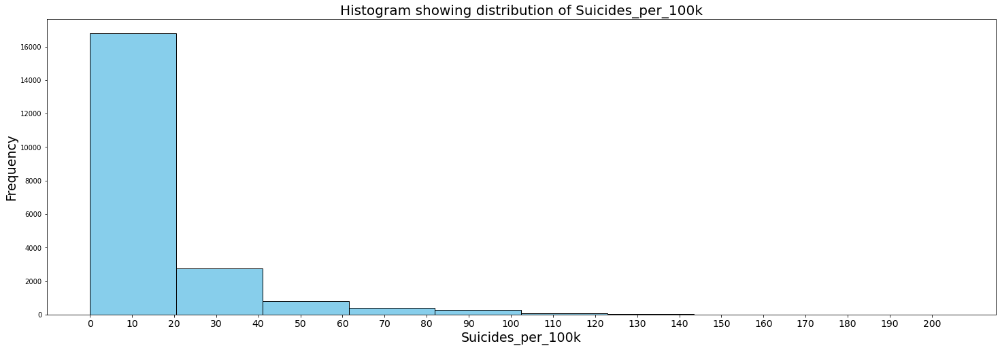

In [14]:
plt.figure(figsize = (25, 8))
bins = np.arange(0, 205, 10)

plt.hist(new_df['Suicides_per_100k'],edgecolor = 'black', facecolor = '#87CEEB')

plt.xticks(np.arange(0, 205, 10), fontsize = 14)

plt.xlabel('Suicides_per_100k', fontsize = 19)

plt.ylabel('Frequency', fontsize = 19)

plt.title('Histogram showing distribution of Suicides_per_100k', fontsize=20)

plt.show()

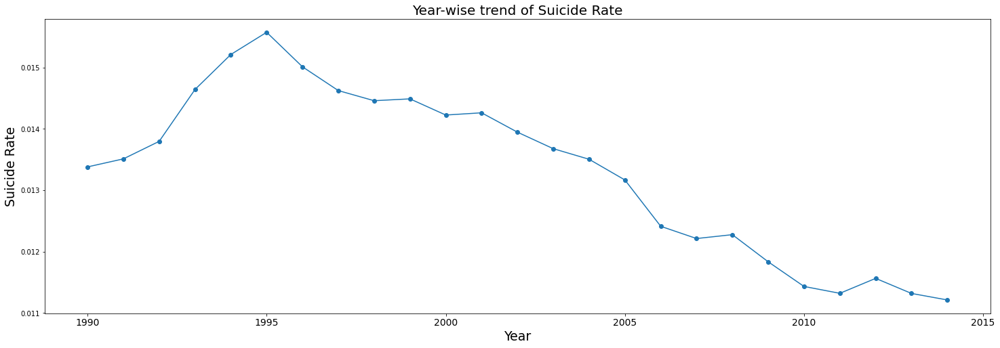

In [15]:
plt.figure(figsize=(25, 8))

df_Rate_by_Year = new_df.groupby(['Year'])[['Population','Number_of_Suicides']].sum().reset_index()

plt.plot(df_Rate_by_Year.Year.values, df_Rate_by_Year.Number_of_Suicides*100/df_Rate_by_Year.Population, marker = 'o')

plt.xticks(fontsize = 14)

plt.xlabel('Year', fontsize = 19)

plt.ylabel('Suicide Rate', fontsize = 19)

plt.title('Year-wise trend of Suicide Rate', fontsize=20)

plt.show()

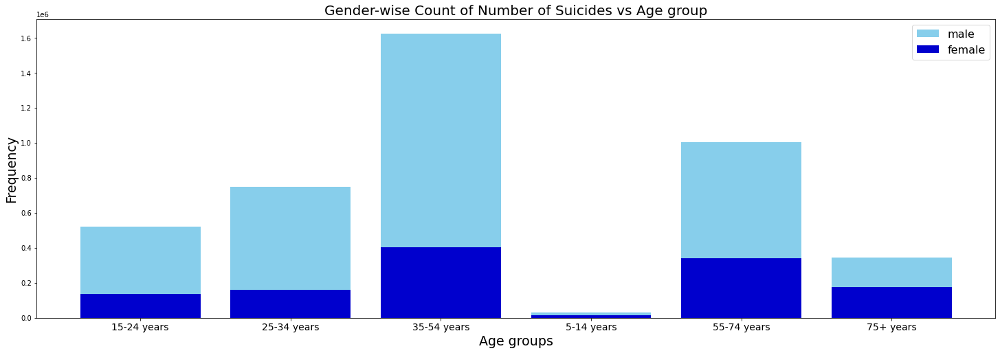

In [16]:
plt.figure(figsize=(25, 8))

Male_Age_SuicideCount = pd.DataFrame(new_df.groupby('Sex').get_group('male').groupby('Age').Number_of_Suicides.sum())

Female_Age_SuicideCount = pd.DataFrame(new_df.groupby('Sex').get_group('female').groupby('Age').Number_of_Suicides.sum())

plt.bar(Male_Age_SuicideCount.index, Male_Age_SuicideCount.Number_of_Suicides, color='#87CEEB')

plt.bar(Female_Age_SuicideCount.index, Female_Age_SuicideCount.Number_of_Suicides, color='#0000CD')

plt.xticks(fontsize = 14)

plt.xlabel('Age groups', fontsize = 19)

plt.ylabel('Frequency', fontsize = 19)

plt.title('Gender-wise Count of Number of Suicides vs Age group', fontsize=20)

plt.legend(['male', 'female'], fontsize=16)

plt.show()

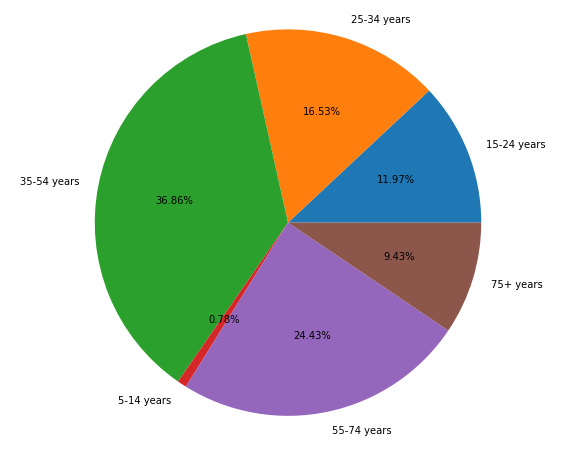

In [17]:
plt.figure(figsize=(10, 8))

pie_data = new_df.groupby(['Age'])[['Number_of_Suicides']].sum()

plt.pie(pie_data.values.reshape(6,), labels=pie_data.index.values, startangle=0, autopct='%1.2f%%')

plt.axis('equal')  

plt.show()

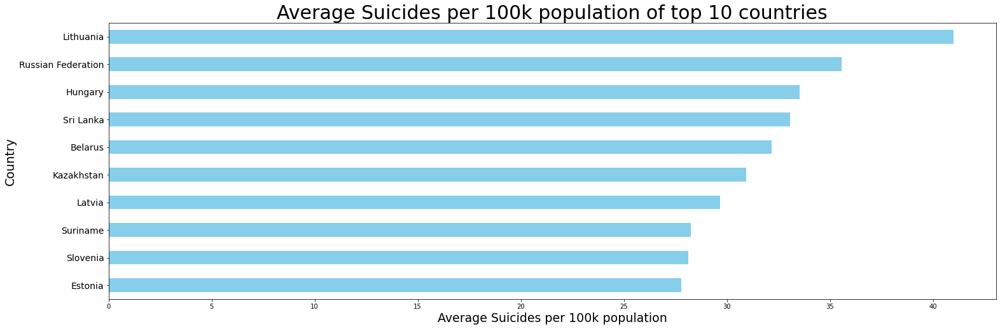

In [18]:
plt.figure(figsize=(25, 8))

new_df.groupby(['Country']).Suicides_per_100k.mean().nlargest(10).sort_values().plot(color='#87CEEB', kind='barh')

plt.yticks(fontsize = 14)

plt.xlabel('Average Suicides per 100k population', fontsize=19)

plt.ylabel('Country', fontsize=19)

plt.title('Average Suicides per 100k population of top 10 countries', fontsize=30)

plt.show()

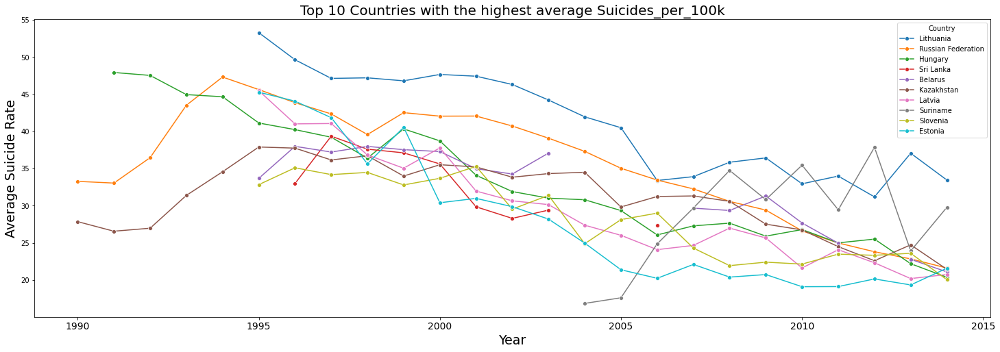

In [19]:
plt.figure(figsize=(25, 8))

temp = pd.DataFrame(new_df.groupby(['Country']).Suicides_per_100k.mean().nlargest(10))
top_10_avg_countries = list(temp.index)

legend = []

for c in top_10_avg_countries: 
    new_df1 = new_df[new_df['Country'] == c]
    legend.append(c)
    sns.lineplot(x="Year", y="Suicides_per_100k",data=new_df1, ci= None, marker='o')
    

plt.legend(title='Country', labels=legend)

plt.xticks(fontsize = 14)

plt.xlabel('Year', fontsize=19)

plt.ylabel('Average Suicide Rate', fontsize=19)

plt.title('Top 10 Countries with the highest average Suicides_per_100k', fontsize=20)

plt.show()

In [20]:
alt.data_transformers.disable_max_rows()
alt.Chart(new_df).mark_bar().encode(
    x=alt.X('Year', bin=alt.Bin(maxbins=8)),
    y='count()',
    color='Generation'
)

alt.Chart(...)

In [21]:
alt.Chart(new_df).mark_point().encode(
    x='Human_Development_Index',
    y= 'Number_of_Suicides',
   
).interactive().properties(title='Number_of_Suicides vs Human_Development_Index')

alt.Chart(...)

In [22]:
alt.Chart(new_df).mark_point().encode(
    x='GDP_per_Capita',
    y='Number_of_Suicides'
).interactive().properties(title='Number_of_Suicides vs GDP_per_Capita')

alt.Chart(...)

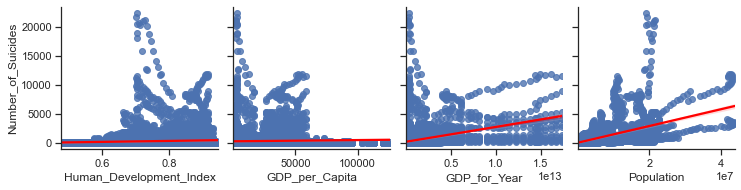

In [23]:
sns.set(style = 'ticks')
sns.pairplot(new_df, y_vars = ["Number_of_Suicides"], x_vars = [ 'Human_Development_Index', 'GDP_per_Capita' , 'GDP_for_Year' , 'Population']
             , kind = 'reg', plot_kws={'line_kws':{'color':'red'}})

<AxesSubplot:>

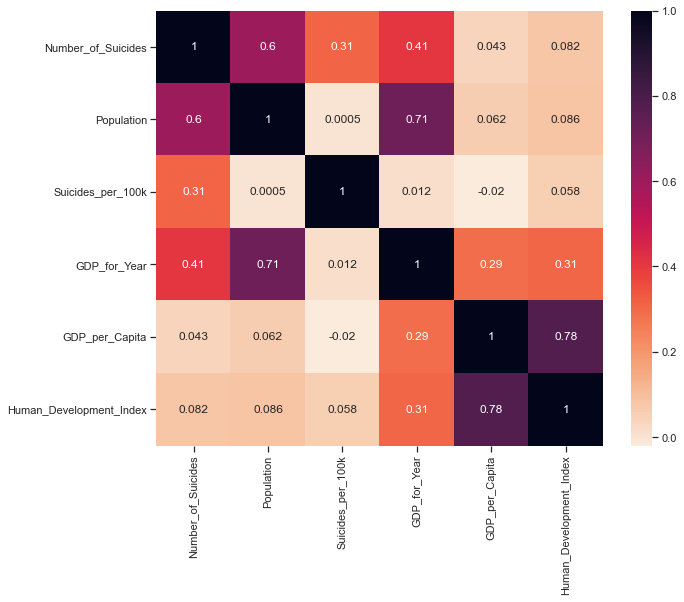

In [24]:
plt.figure(figsize =(10,8))
corrmat = new_df.corr()
sns.heatmap(corrmat,cmap = sns.cm.rocket_r, annot=True)

## Goal 1: Predict the number of suicides based on the input predictors to the model

Linear Regression

In [25]:
import statsmodels.formula.api as smf

In [26]:
# Approach 1-Choosing all predictors : Full model

model_full = 'Number_of_Suicides ~ Human_Development_Index + GDP_per_Capita + GDP_for_Year + Country + Sex + Age + Generation + Population + Year' 

result_full = smf.ols(formula = model_full, data = new_df).fit()  

print('MSE:',result_full.mse_resid)
print('R2:',result_full.rsquared)
print('R2_adj:',result_full.rsquared_adj)


MSE: 426189.89259247744
R2: 0.5497678011305825
R2_adj: 0.5471978604054563


In [27]:
# Approach 2- Building a model with interactions (observed from heat maps)

model_interactions = 'Number_of_Suicides ~ Human_Development_Index + GDP_per_Capita + GDP_for_Year + Country + Sex + Age + Generation + Population + Year + Human_Development_Index:GDP_per_Capita + \
Population:GDP_for_Year' 

result_interactions = smf.ols(formula = model_interactions, data = new_df).fit()  

print('MSE:',result_interactions.mse_resid)
print('R2:',result_interactions.rsquared)
print('R2_adj:',result_interactions.rsquared_adj)

MSE: 597018.3163942941
R2: 0.3657625296989724
R2_adj: 0.3657025289922602


In [28]:
# Approach 3- Significant predictors only

model_significant = 'Number_of_Suicides ~ Human_Development_Index + GDP_for_Year + Country + Population + Year + Age + Country' 

result_significant = smf.ols(formula = model_significant, data = new_df).fit()  

print('MSE:',result_significant.mse_resid)
print('R2:',result_significant.rsquared)
print('R2_adj:',result_significant.rsquared_adj)

MSE: 450061.51304550964
R2: 0.5244138358547412
R2_adj: 0.5218356427541393


In [29]:
# Approach 4- Log transformation of the predictors 

model_log = 'Number_of_Suicides ~ np.log(Human_Development_Index) + GDP_per_Capita + np.log(GDP_for_Year) + Country + Sex + Age + Generation + Population + Year' 

result_log = smf.ols(formula = model_log, data = new_df).fit()  

print('MSE:',result_log.mse_resid)
print('R2:',result_log.rsquared)
print('R2_adj:',result_log.rsquared_adj)

MSE: 426456.6571503161
R2: 0.5496788539985373
R2_adj: 0.5469144384739257


In [30]:
result_full.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:     Number_of_Suicides   R-squared:                       0.550
Model:                            OLS   Adj. R-squared:                  0.547
Method:                 Least Squares   F-statistic:                     213.9
Date:                Mon, 21 Dec 2020   Prob (F-statistic):               0.00
Time:                        11:42:49   Log-Likelihood:            -1.6698e+05
No. Observations:               21144   AIC:                         3.342e+05
Df Residuals:                   21023   BIC:                         3.352e+05
Df Model:                         120                                         
Covariance Type:            nonrobust                                         
=====================================================================================================
                                        coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
Intercept                           538.7189    230.101      2.341      0.019      87.703     989.735
Country[T.Antigua and Barbuda]      131.8435     83.414      1.581      0.114     -31.655     295.342
Country[T.Argentina]                -88.2852     67.874     -1.301      0.193    -221.323      44.753
Country[T.Armenia]                   -6.7394     58.608     -0.115      0.908    -121.615     108.136
Country[T.Australia]                268.6123    104.385      2.573      0.010      64.009     473.216
Country[T.Austria]                  266.2853     89.047      2.990      0.003      91.747     440.824
Country[T.Azerbaijan]               -95.4616     72.316     -1.320      0.187    -237.207      46.284
Country[T.Bahamas]                  143.9625     76.508      1.882      0.060      -6.000     293.925
Country[T.Bahrain]                  151.5760     72.517      2.090      0.037       9.436     293.716
Country[T.Barbados]                 153.6493     70.335      2.185      0.029      15.788     291.511
Country[T.Belarus]                  201.8489     65.832      3.066      0.002      72.813     330.885
Country[T.Belgium]                  313.6710     95.425      3.287      0.001     126.630     500.712
Country[T.Belize]                    11.5737     58.460      0.198      0.843    -103.012     126.159
Country[T.Bosnia and Herzegovina]    48.8425    141.302      0.346      0.730    -228.121     325.806
Country[T.Brazil]                 -1551.2240     67.462    -22.994      0.000   -1683.455   -1418.993
Country[T.Bulgaria]                 103.8072     61.198      1.696      0.090     -16.146     223.760
Country[T.Cabo Verde]               -41.6829    198.357     -0.210      0.834    -430.479     347.113
Country[T.Canada]                   218.4624     98.645      2.215      0.027      25.110     411.815
Country[T.Chile]                     74.3888     66.484      1.119      0.263     -55.925     204.703
Country[T.Colombia]                -326.9972     57.910     -5.647      0.000    -440.505    -213.489
Country[T.Costa Rica]                61.8290     59.474      1.040      0.299     -54.746     178.404
Country[T.Croatia]                  159.7743     68.221      2.342      0.019      26.056     293.492
Country[T.Cuba]                      78.7274     59.769      1.317      0.188     -38.424     195.879
Country[T.Cyprus]                   198.3344     85.256      2.326      0.020      31.227     365.442
Country[T.Denmark]                  263.2379     99.647      2.642      0.008      67.922     458.553
Country[T.Ecuador]                  -50.6749     57.591     -0.880      0.379    -163.557      62.207
Country[T.El Salvador]              -74.9360     62.706     -1.195      0.232    -197.845      47.974
Country[T.Estonia]     

Using Linear Regression to predict the Number of Suicides

In [31]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import make_column_transformer 
from sklearn import linear_model
from sklearn.pipeline import make_pipeline

In [32]:
ohe = OneHotEncoder(sparse = False) # instantiate

In [33]:
column_trans = make_column_transformer((OneHotEncoder(), ['Country', 'Sex', 'Age', 'Generation', 'Year']), 
                       remainder = 'passthrough'
                       )

In [34]:
X_suicide = LR_df[['Human_Development_Index', 'GDP_per_Capita' , 'GDP_for_Year' , 'Country' , 'Sex' , 'Age' , 'Generation' , 'Population' , 'Year']] # creating feature matrix of credit like we did for adv

X_suicide.head(10)

,Human_Development_Index,GDP_per_Capita,GDP_for_Year,Country,Sex,Age,Generation,Population,Year
0,0.608,251.0,709452584.0,Albania,male,35-54 years,Boomers,343800.0,1992
1,0.608,251.0,709452584.0,Albania,male,15-24 years,Generation X,263700.0,1992
2,0.608,251.0,709452584.0,Albania,male,55-74 years,Silent,159500.0,1992
3,0.608,251.0,709452584.0,Albania,male,25-34 years,Boomers,245500.0,1992
4,0.608,251.0,709452584.0,Albania,female,15-24 years,Generation X,292400.0,1992
5,0.608,251.0,709452584.0,Albania,female,25-34 years,Boomers,267400.0,1992
6,0.608,251.0,709452584.0,Albania,female,35-54 years,Boomers,323100.0,1992
7,0.608,251.0,709452584.0,Albania,female,55-74 years,Silent,164900.0,1992
8,0.608,251.0,709452584.0,Albania,female,5-14 years,Millenials,336700.0,1992
9,0.608,251.0,709452584.0,Albania,female,75+ years,G.I. Generation,38700.0,1992


In [35]:
np.set_printoptions(edgeitems = 10) 

column_trans.fit_transform(X_suicide)

<21144x134 sparse matrix of type '<class 'numpy.float64'>'
	with 190296 stored elements in Compressed Sparse Row format>

In [36]:
lr = linear_model.LinearRegression()
pipe = make_pipeline(column_trans, lr)

In [37]:
pipe.fit(X_suicide, LR_df['Number_of_Suicides'])

Pipeline(steps=[('columntransformer',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('onehotencoder',
                                                  OneHotEncoder(),
                                                  ['Country', 'Sex', 'Age',
                                                   'Generation', 'Year'])])),
                ('linearregression', LinearRegression())])

In [38]:
X_new = X_suicide.sample(3, random_state = 1) 
X_new

,Human_Development_Index,GDP_per_Capita,GDP_for_Year,Country,Sex,Age,Generation,Population,Year
6030,0.905,55354.0,2.828849e+11,Denmark,male,15-24 years,Millenials,312053.0,2006
11471,0.725,2232.0,3.083370e+10,Kazakhstan,female,5-14 years,Millenials,1316237.0,2003
8540,0.866,22834.0,2.370296e+11,Greece,female,25-34 years,Millenials,689746.0,2014


In [39]:
pipe.predict(X_new).round()

array([ 15., 173.,  73.])

## Goal 2: Classifying the instances in the dataset based on whether they are at a risk of suicide or not

Classification model 1: Logistic Regression

In [40]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import recall_score, precision_score
from sklearn.metrics import r2_score
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score

In [41]:
le = LabelEncoder()

new_df.Country = le.fit_transform(new_df.Country)  # Alphabetic order [0:40]
new_df.Sex = le.fit_transform(new_df.Sex)
new_df.Age = le.fit_transform(new_df.Age)
new_df.Generation = le.fit_transform(new_df.Generation)
new_df.Year = le.fit_transform(new_df.Year)

In [42]:
# New target variable created for classification model
new_df['Suicide_risk'] = np.where(new_df['Suicides_per_100k']>new_df['Suicides_per_100k'].mean(), 1, 0)
new_df

,Country,Year,Sex,Age,Number_of_Suicides,Population,Suicides_per_100k,Country-Year,GDP_for_Year,GDP_per_Capita,Generation,Human_Development_Index,Suicide_risk
0,0,2,1,2,12.0,343800.0,3.49,Albania1992,7.094526e+08,251.0,0,0.608,0
1,0,2,1,0,9.0,263700.0,3.41,Albania1992,7.094526e+08,251.0,2,0.608,0
2,0,2,1,4,5.0,159500.0,3.13,Albania1992,7.094526e+08,251.0,5,0.608,0
3,0,2,1,1,7.0,245500.0,2.85,Albania1992,7.094526e+08,251.0,0,0.608,0
4,0,2,0,0,7.0,292400.0,2.39,Albania1992,7.094526e+08,251.0,2,0.608,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
22567,90,24,0,2,107.0,3620833.0,2.96,Uzbekistan2014,6.306708e+10,2309.0,2,0.693,0
22568,90,24,0,5,9.0,348465.0,2.58,Uzbekistan2014,6.306708e+10,2309.0,5,0.693,0
22569,90,24,1,3,60.0,2762158.0,2.17,Uzbekistan2014,6.306708e+10,2309.0,3,0.693,0
22570,90,24,0,3,44.0,2631600.0,1.67,Uzbekistan2014,6.306708e+10,2309.0,3,0.693,0


In [43]:
new_df['Suicide_risk'].unique()

array([0, 1])

In [44]:
new_df['Suicide_risk'].value_counts()

0    14534
1     6610
Name: Suicide_risk, dtype: int64

In [45]:
X_log_sui = new_df[['Human_Development_Index', 'GDP_per_Capita' , 'GDP_for_Year' , 'Country' , 'Sex' , 'Year', 'Age', 'Generation' , 'Population']] 
y_log_sui = new_df['Suicide_risk']

In [46]:
scaler = StandardScaler()
scaler.fit(X_log_sui)
X_scaled = scaler.transform(X_log_sui)

In [47]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_log_sui, test_size = 0.2, random_state = 77, stratify = y_log_sui) 


In [48]:
LR = LogisticRegression().fit(X_train, y_train) #C=0.002, solver='liblinear'
 
yLRhat = LR.predict(X_test)

yLRhat_prob = LR.predict_proba(X_test)

print('precision_recall_fscore_support', precision_recall_fscore_support(y_test, yLRhat, average='weighted'))



precision_recall_fscore_support (0.7499947688289428, 0.7559706786474344, 0.7521431601963269, None)


In [49]:
cm = confusion_matrix(y_test, yLRhat)
print('\n confusion matrix \n', cm)



 confusion matrix 
 [[2459  448]
 [ 584  738]]


In [50]:
print('classification report for Logistic Regression\n', classification_report(y_test, yLRhat))

classification report for Logistic Regression
               precision    recall  f1-score   support

           0       0.81      0.85      0.83      2907
           1       0.62      0.56      0.59      1322

    accuracy                           0.76      4229
   macro avg       0.72      0.70      0.71      4229
weighted avg       0.75      0.76      0.75      4229



In [51]:
accuracy = accuracy_score(y_test, yLRhat)
print('Logistic Regression Accuracy:', accuracy)

Logistic Regression Accuracy: 0.7559706786474344


In [52]:
fpr, tpr, thresholds = roc_curve(y_test, yLRhat)

In [53]:
auc = roc_auc_score(y_test, yLRhat)
print('AUC of Logistic Regression model: %.3f' % auc)

AUC of Logistic Regression model: 0.702


K-Fold sampling for Logistic regression

In [54]:
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score


In [55]:
cv = StratifiedKFold(n_splits = 5, shuffle=True, random_state=99)

In [56]:
print('ROC AUC scores for 5 fold Logistic regression model')
cross_val_score(LR, X_scaled, y_log_sui, cv=cv, scoring='roc_auc')

ROC AUC scores for 5 fold Logistic regression model


array([0.80792255, 0.81539031, 0.81722869, 0.81431148, 0.81337975])

Classification model 2: Support Vector Machines (SVM)

In [57]:
from sklearn.svm import SVC
    
svm = SVC().fit(X_train, y_train)
svc_predictions = svm.predict(X_test)

svc_accuracy = svm.score(X_test, y_test)
print('SVM Accuracy:', svc_accuracy)

SVM Accuracy: 0.8576495625443368


In [58]:
svc_recall = recall_score(y_test, svc_predictions)
print('Recall of SVM model:',svc_recall)
svc_precision = precision_score(y_test, svc_predictions)
print('Precision of SVM model:',svc_precision)

Recall of SVM model: 0.716338880484115
Precision of SVM model: 0.8066439522998297


Classification model 3: K-Nearest Neighbors (KNN)

In [59]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics

In [60]:
knn = KNeighborsClassifier(n_neighbors=3) 

knn.fit(X_train, y_train)

y_pred = knn.predict(X_test)

print('Accuracy of KNN:',metrics.accuracy_score(y_test, y_pred)*100,'%')
print('Precision_recall_fscore_support of KNN', precision_recall_fscore_support(y_test, y_pred, average='weighted'))

Accuracy of KNN: 92.85883187514779 %
Precision_recall_fscore_support of KNN (0.9292533474158379, 0.9285883187514778, 0.9288454831497063, None)


In [61]:
cm = confusion_matrix(y_test, y_pred)
print('\n confusion matrix \n', cm)


 confusion matrix 
 [[2738  169]
 [ 133 1189]]


In [62]:
print('ROC AUC scores for 5 fold KNN model')
cross_val_score(knn, X_scaled, y_log_sui, cv = 5, scoring='roc_auc')

ROC AUC scores for 5 fold KNN model


array([0.8081868 , 0.74840101, 0.74149869, 0.74844785, 0.78322043])

## Goal 3: Clustering the instances in the dataset based on their economic condition 

In [63]:
from sklearn.cluster import KMeans

In [64]:
X_cluster = new_df[['Human_Development_Index', 'GDP_per_Capita' , 'Suicides_per_100k']] 
scaler = StandardScaler()
scaler.fit(X_cluster)
X_cluster_scaled = scaler.transform(X_cluster)

In [65]:
X_scaled_df = pd.DataFrame(X_cluster_scaled, columns = ['Human_Development_Index', 'GDP_per_Capita' , 'Suicides_per_100k'])
X_scaled_df

,Human_Development_Index,GDP_per_Capita,Suicides_per_100k
0,-1.713137,-0.913743,-0.506964
1,-1.713137,-0.913743,-0.511144
2,-1.713137,-0.913743,-0.525772
3,-1.713137,-0.913743,-0.540400
4,-1.713137,-0.913743,-0.564431
...,...,...,...
21139,-0.808619,-0.810974,-0.534653
21140,-0.808619,-0.810974,-0.554505
21141,-0.808619,-0.810974,-0.575925
21142,-0.808619,-0.810974,-0.602046


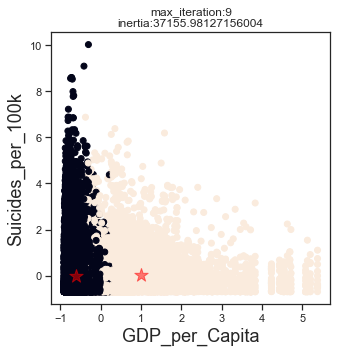

In [66]:
plt.figure(figsize = (5,5))

kmeans = KMeans(n_clusters = 2, init = 'random', n_init = 1, random_state = 66)

kmeans.fit(X_scaled_df)

plt.xlabel('GDP_per_Capita', fontsize=18)
plt.ylabel('Suicides_per_100k', rotation = 90, fontsize=18)
plt.title('Scatterplot of spendings in Population vs GDP_for_Year', fontsize=20)

centroids = kmeans.cluster_centers_

plt.scatter(x = 'GDP_per_Capita', y = 'Suicides_per_100k', data = X_scaled_df, c = kmeans.labels_)
plt.scatter(centroids[:, 1], centroids[:, 2], c = 'red', s = 200, alpha = 0.5, marker = '*')
plt.title('max_iteration:'+ str(kmeans.n_iter_) + '\n' + 'inertia:' + str(kmeans.inertia_))

plt.show()

In [67]:
from sklearn.metrics import silhouette_score

silhouette = []

for k in range(2, 10):
    kmeans = KMeans(n_clusters = k, n_init = 30, random_state = 99).fit(X_scaled_df)
    
    silhouette.append([k, silhouette_score(X_scaled_df, kmeans.labels_)])
    
silhouette 

[[2, 0.4266942353725141],
 [3, 0.4778294101022796],
 [4, 0.4067519594933476],
 [5, 0.35221748940393816],
 [6, 0.36286744388836],
 [7, 0.3576960817716201],
 [8, 0.37031635347663033],
 [9, 0.3391069489499421]]

Text(0.5, 1.0, 'Inertia vs number of clusters - k')

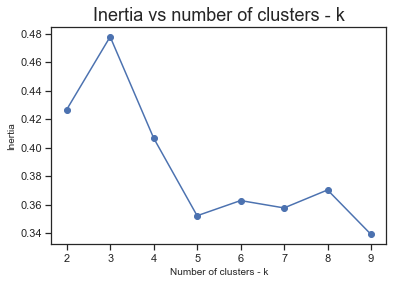

In [68]:
plt.plot(pd.DataFrame(silhouette)[0], pd.DataFrame(silhouette)[1], marker = 'o')
plt.xlabel('Number of clusters - k', fontsize=10)
plt.ylabel('Inertia', rotation = 90, fontsize=10)
plt.title('Inertia vs number of clusters - k', fontsize=18)

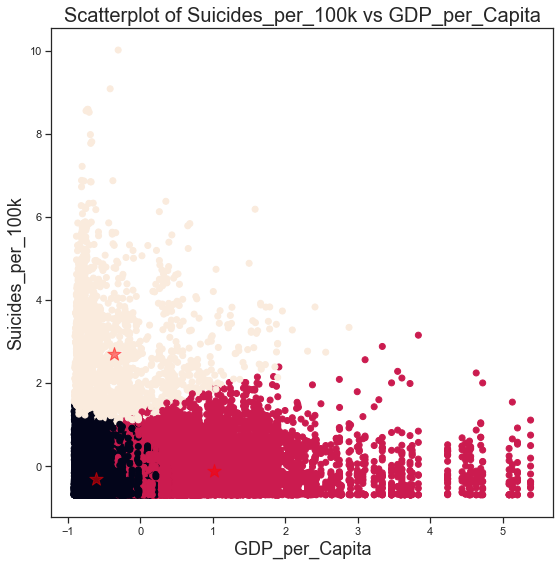

In [69]:
plt.figure(figsize = (9,9))

kmeans = KMeans(n_clusters = 3, init = 'random', n_init = 30, random_state = 99)

kmeans.fit(X_scaled_df)

plt.xlabel('GDP_per_Capita', fontsize=18)
plt.ylabel('Suicides_per_100k', rotation = 90, fontsize=18)
plt.title('Scatterplot of Suicides_per_100k vs GDP_per_Capita', fontsize=20)

centroids = kmeans.cluster_centers_

plt.scatter(x = 'GDP_per_Capita', y = 'Suicides_per_100k', data = X_scaled_df, c = kmeans.labels_)
plt.scatter(centroids[:, 1], centroids[:, 2], c = 'red', s = 200, alpha = 0.5, marker = '*')


plt.show()

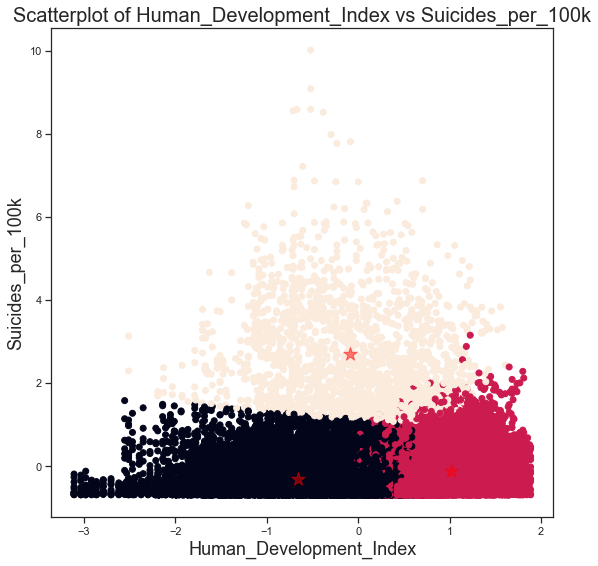

In [70]:
plt.figure(figsize = (9,9))

kmeans = KMeans(n_clusters = 3, init = 'random', n_init = 30, random_state = 99)

kmeans.fit(X_scaled_df)

plt.xlabel('Human_Development_Index', fontsize=18)
plt.ylabel('Suicides_per_100k', rotation = 90, fontsize=18)
plt.title('Scatterplot of Human_Development_Index vs Suicides_per_100k', fontsize=20)

centroids = kmeans.cluster_centers_

plt.scatter(x = 'Human_Development_Index', y = 'Suicides_per_100k', data = X_scaled_df, c = kmeans.labels_)
plt.scatter(centroids[:, 0], centroids[:, 2], c = 'red', s = 200, alpha = 0.5, marker = '*')

plt.show()

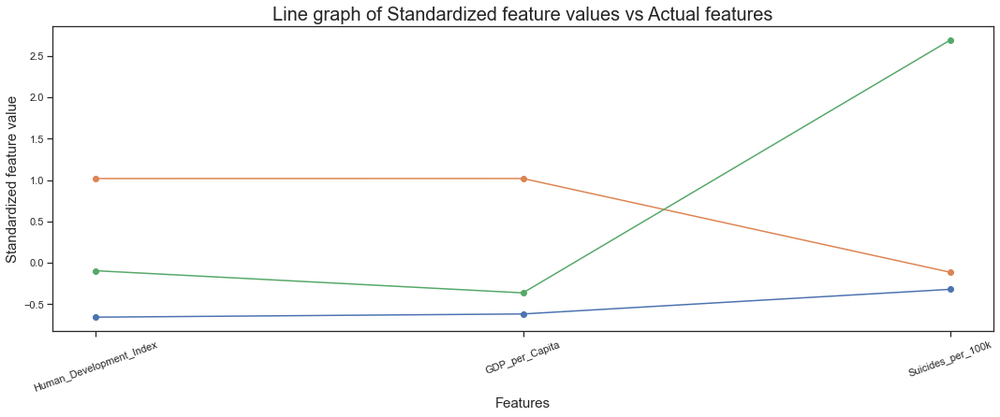

In [71]:
plt.figure(figsize = (18,6))

plt.plot(np.transpose(kmeans.cluster_centers_), marker = 'o')

plt.xticks(np.arange(3), X_scaled_df.columns, rotation = 20)

plt.xlabel('Features', fontsize=15)
plt.ylabel('Standardized feature value', rotation = 90, fontsize=15)
plt.title('Line graph of Standardized feature values vs Actual features', fontsize=20)
plt.show()

In [72]:
scaler.inverse_transform(kmeans.cluster_centers_)

array([[7.07390325e-01, 6.19989293e+03, 7.08401075e+00],
       [8.64645258e-01, 3.89434990e+04, 1.10175295e+01],
       [7.60105478e-01, 1.13024779e+04, 6.47027448e+01]])

In [73]:
df_cluster = pd.DataFrame(scaler.inverse_transform(kmeans.cluster_centers_), 
             columns = ['Human_Development_Index', 'GDP_per_Capita' , 'Suicides_per_100k'], index = ['Cluster 1- Underdeveloped countries', 'Cluster 3- Developed countries', 'Cluster 2- Developing countries'])
df_cluster.sort_values(by=['Suicides_per_100k'], inplace = True)
df_cluster

,Human_Development_Index,GDP_per_Capita,Suicides_per_100k
Cluster 1- Underdeveloped countries,0.707390,6199.892927,7.084011
Cluster 3- Developed countries,0.864645,38943.499027,11.017530
Cluster 2- Developing countries,0.760105,11302.477855,64.702745


## Goal 4 : Forecasting the total number of suicides for the future years by training the model on the historical data

In [74]:
from pmdarima.arima import auto_arima

In [75]:
LR_df_new = pd.DataFrame(LR_df.groupby(['Year']).Number_of_Suicides.sum())

LR_df_new

,Number_of_Suicides
Year,
1990.0,183645.0
1991.0,188476.0
1992.0,170714.0
1993.0,210549.0
1994.0,220598.0
1995.0,234729.0
1996.0,236779.0
1997.0,200151.0
1998.0,236861.0


In [76]:
LR_df_new.index = LR_df_new.index.astype(str).str.strip()
LR_df_new

,Number_of_Suicides
Year,
1990.0,183645.0
1991.0,188476.0
1992.0,170714.0
1993.0,210549.0
1994.0,220598.0
1995.0,234729.0
1996.0,236779.0
1997.0,200151.0
1998.0,236861.0


In [77]:
LR_df_new.index.astype(object)

Index(['1990.0', '1991.0', '1992.0', '1993.0', '1994.0', '1995.0', '1996.0',
       '1997.0', '1998.0', '1999.0', '2000.0', '2001.0', '2002.0', '2003.0',
       '2004.0', '2005.0', '2006.0', '2007.0', '2008.0', '2009.0', '2010.0',
       '2011.0', '2012.0', '2013.0', '2014.0'],
      dtype='object', name='Year')

In [78]:
LR_df_new.index = pd.to_datetime(LR_df_new.index, format = '%Y.0',errors = 'coerce')

LR_df_new

,Number_of_Suicides
Year,
1990-01-01,183645.0
1991-01-01,188476.0
1992-01-01,170714.0
1993-01-01,210549.0
1994-01-01,220598.0
1995-01-01,234729.0
1996-01-01,236779.0
1997-01-01,200151.0
1998-01-01,236861.0


In [79]:
training_data = LR_df_new[:int(0.9*(len(LR_df_new)))]
validation_data = LR_df_new[int(0.85*(len(LR_df_new))):]

In [80]:
model = auto_arima(training_data, trace=True, error_action='ignore', suppress_warnings=True)

model.fit(training_data)

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=508.470, Time=1.25 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=502.640, Time=0.06 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=492.476, Time=0.04 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=497.821, Time=0.12 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=606.210, Time=0.01 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=494.913, Time=0.06 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=502.368, Time=0.06 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.33 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=0.05 sec

Best model:  ARIMA(1,0,0)(0,0,0)[0] intercept
Total fit time: 2.460 seconds


ARIMA(order=(1, 0, 0), scoring_args={}, suppress_warnings=True)

In [81]:
validation_forecast = model.predict(n_periods=len(validation_data))
validation_forecast = pd.DataFrame(validation_forecast,index = validation_data.index,columns=['Prediction-(No.ofSuicides)'])

In [82]:
# Actual validation data (Gold-standard)
validation_data

,Number_of_Suicides
Year,
2011-01-01,218716.0
2012-01-01,214085.0
2013-01-01,206955.0
2014-01-01,207439.0


In [83]:
# Forecasted by the model
validation_forecast.round()

,Prediction-(No.ofSuicides)
Year,
2011-01-01,219037.0
2012-01-01,219232.0
2013-01-01,219351.0
2014-01-01,219422.0


<AxesSubplot:xlabel='Year', ylabel='Prediction-(No.ofSuicides)'>

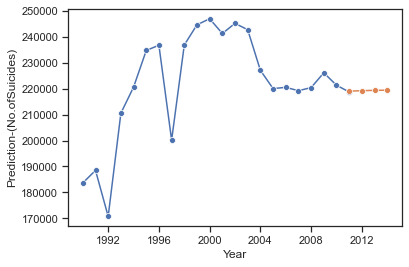

In [84]:
sns.lineplot(x=training_data.index, y="Number_of_Suicides",data=training_data, ci= None, marker='o')

sns.lineplot(x=validation_data.index, y="Prediction-(No.ofSuicides)",data=validation_forecast, ci= None, marker='o')

Forecasting on new (unseen data) : Test data

In [85]:
# Creating the dataset for next years
X_new = pd.DataFrame(columns=validation_forecast.columns, 
                     index=['2015', '2016'])
X_new.index = pd.to_datetime(X_new.index, format = '%Y',errors = 'coerce')

In [86]:
forecast_X_new = model.predict(n_periods=len(X_new))
forecast_X_new.round()

array([219037., 219232.])

In [87]:
# Prediction of Number of Suicides made for next 2 years
test = pd.DataFrame(forecast_X_new.round(),index = X_new.index,columns=['Prediction-(No.ofSuicides)'])
test

,Prediction-(No.ofSuicides)
2015-01-01,219037.0
2016-01-01,219232.0
